## Paris Hilton - Sentiment Analysis

### Sources:

##### https://www.kaggle.com/code/mfaaris/sentiment-using-sklearn-and-tensorflow
##### https://www.kaggle.com/code/emirkocak/in-depth-series-sentiment-analysis-w-transformers
##### https://www.kaggle.com/code/avnika22/imdb-perform-sentiment-analysis-with-scikit-learn

In [1]:
# PUT IN TERMINAL FIRST: pip install ntlk

In [2]:
# must do before start of notebook
#pip install wordcloud

In [3]:
#pip install plotly

In [4]:
# import libraries (NOTE: nltk may require a pip download)
import pandas as pd
import numpy as np
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

#sentiment analysis + model tools 
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score
from sklearn.preprocessing import LabelBinarizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import confusion_matrix, classification_report
nltk.download('stopwords')
from nltk.corpus import stopwords
stopWords_nltk = set(stopwords.words('english'))
import re
import string
import pickle
from typing import Union, List
from collections import Counter, defaultdict

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import BernoulliNB

# viz tools
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.ticker import MaxNLocator
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from plotly.offline import plot
import plotly.offline as pyo
# Set notebook mode to work in offline
pyo.init_notebook_mode()

#plotly needs fig_pie.show(renderer='iframe')

[nltk_data] Downloading package stopwords to /home/jovyan/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [5]:
df = pd.read_csv('marriott_clean.csv',low_memory=False)

In [6]:
df.head()

,Response Date,Survey ID,Market Code/Rate Plan,Market Segment,Check-in Associate (BTR),Room Rate (derived),Room Number,Room Types,Survey language,Arrival Date,Departure Date,Company Name,Loyalty Program Tier,Mobile Check-In,Intent to Recommend (Property),Overall Comment,Elite Appreciation,Cleanliness,Staff Service,Food and Beverage,Maintenance and Upkeep,Design and Décor,F&B: Service,F&B: Quality of Food,Fitness Center Satisfaction,"MH: Trusted, quality experience",Reason for Brand Question Rating,Restaurant 1 Name,Restaurant 1 Cuisine Type,Restaurant 1 Service Satisfaction:,Restaurant 1 Food Quality Satisfaction:,Restaurant 2 Name,Restaurant 2 Cuisine Type,Restaurant 2 Service Satisfaction:,Restaurant 2 Food Quality Satisfaction:,Other Hotel Restaurant(s) Used,Restaurants Eaten At,Reason for Trip,Property (Exterior and Interior) Overall,Public Spaces/Lobby Area,Staff Service Overall,Room Overall,Room Cleanliness,Bathroom Overall,Check-In Experience,Food and Beverage.1,Other,Other Amenity Description,Internet,Lounge (Executive/Concierge/Club),Fitness Center,Pool,Intent to Consider Brand,MH: Bar/Lounge Energy & Ambiance,MH: Feel Inspired/Creative,Meeting Attendee Satisfaction,Intent to Recommend (Marriott International),Experienced Problem,Bell Staff,Billing/Rates,Broken Items,Check-In,Check-Out,Heating/Cooling Systems Problem,Hotel/Room Maintenance,Internet Connectivity,Mobile App,Noise,Noise Problem Resolution,Parking,Parking Problem Resolution,Recreation Facilities,Reservation Accuracy,Loyalty Program Issue,Cleanliness/Housekeeping,Room Cleanliness/Housekeeping Problem Resolution,Room Location/Type,Room Smell,Staff,TV/Remote,Bathroom,Other (Specify:),Other - Text,Other Problem Resolution,Food & beverage quality,Food & beverage service,Social Media Source,Overall Score,Social Comment
0,2/9/24 16:07,2298496229,17BQQC,Transient,"RIVERA, RICARDO",184.00,811,PQ,English,1/29/24,2/2/24,BOOZE ALLEN,Titanium,No,6.0,"Stay was alright, but the shower was scolding ...",5.0,7.0,7.0,8.0,7.0,7.0,NaN,NaN,5,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Meeting,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0,NaN
1,2/9/24 4:56,2301780802,NaN,NaN,NaN,NaN,NaN,NaN,English,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,GOOGLE_LOCAL,1.0,My boyfriend had gotten us a room here after a...
2,2/8/24 23:35,2301535502,NaN,NaN,NaN,NaN,NaN,NaN,English (United States),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,MARRIOTT,5.0,We were very comfortable during our stay. The ...
3,2/8/24 23:22,2300922062,38BK3A,Transient,"MANGROBANG, ANGEL",0.00,203,GKA,English,1/31/24,2/3/24,NaN,Member,No,10.0,"Clean comfortable room, very friendly and help...",NaN,10.0,10.0,NaN,10.0,9.0,NaN,NaN,Did Not Use,10.0,A wonderful place to stay,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Family,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0,NaN
4,2/8/24 14:09,2297873520,17HEWV,Transient,"EDRAISA, KRISTIAN",146.33,1721,CK,English,1/29/24,2/1/24,NaN,Ambassador,Yes,4.0,I checked in and the room I was not able to ge...,2.0,8.0,6.0,6.0,4.0,8.0,NaN,NaN,Did Not Use,4.0,I asked the front desk to help locate a room f...,Concierge Lounge (e.g. Executive or Club Lounge),Concierge Loung

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22838 entries, 0 to 22837
Data columns (total 89 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0    Response Date                                    22838 non-null  object 
 1   Survey ID                                         22838 non-null  int64  
 2   Market Code/Rate Plan                             14989 non-null  object 
 3   Market Segment                                    14989 non-null  object 
 4   Check-in Associate (BTR)                          14179 non-null  object 
 5   Room Rate (derived)                               14989 non-null  float64
 6   Room Number                                       14989 non-null  object 
 7   Room Types                                        14989 non-null  object 
 8   Survey language                                   22838 non-null  object 
 9   Arrival Date     

In [8]:
df['Overall Score'].describe()

count    22838.000000
mean         4.062114
std          1.206081
min          0.500000
25%          3.500000
50%          4.500000
75%          5.000000
max          5.000000
Name: Overall Score, dtype: float64

In [9]:
df['Overall Score'].value_counts()

Overall Score
5.00    9783
4.00    3713
4.50    2764
3.50    1323
3.00    1229
2.50     749
2.00     685
0.50     668
1.00     610
1.50     408
3.75     141
4.80     114
4.60     104
4.15      87
3.55      81
3.95      69
4.40      69
3.35      59
3.15      50
2.90      29
2.70      19
1.90      16
2.30      16
1.25      14
2.10      14
1.65       6
1.45       5
3.10       3
4.20       2
4.70       2
2.75       1
2.20       1
3.25       1
4.75       1
4.25       1
4.35       1
Name: count, dtype: int64

In [10]:
# convert reviews to .5 values
df['review_score'] = (np.ceil(df['Overall Score'] * 2) / 2)

In [11]:
df['review_date'] = pd.to_datetime(df[' Response Date '], format= '%m/%d/%y %H:%M')

In [12]:
df['review_month_year'] = df['review_date'].dt.to_period('M')

In [13]:
df['review_year'] = df['review_date'].dt.year

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



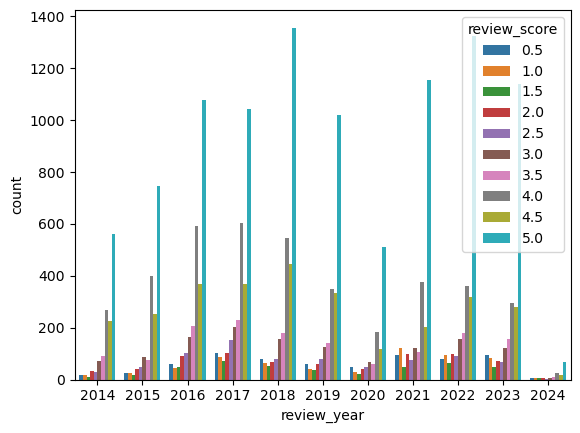

In [14]:
sns.countplot(x="review_year", hue="review_score", data=df);

<Axes: xlabel='review_year'>

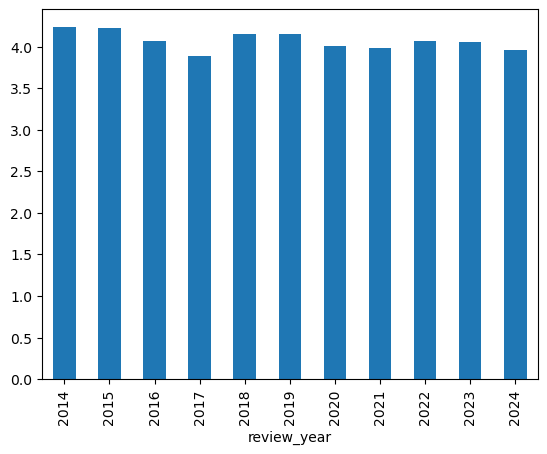

In [15]:
df.groupby("review_year")["review_score"].mean().plot(kind='bar')

In [16]:
# WHEN USING PLOTLY IN JUPYTER NOTEBOOKS YOU NEED THIS IN THE fig.show()
# renderer='iframe'

In [17]:
fig_pie = px.pie(df, values='review_score', names='review_score')
fig_pie.show(renderer='iframe')

## Sentiment Analysis

In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22838 entries, 0 to 22837
Data columns (total 93 columns):
 #   Column                                            Non-Null Count  Dtype         
---  ------                                            --------------  -----         
 0    Response Date                                    22838 non-null  object        
 1   Survey ID                                         22838 non-null  int64         
 2   Market Code/Rate Plan                             14989 non-null  object        
 3   Market Segment                                    14989 non-null  object        
 4   Check-in Associate (BTR)                          14179 non-null  object        
 5   Room Rate (derived)                               14989 non-null  float64       
 6   Room Number                                       14989 non-null  object        
 7   Room Types                                        14989 non-null  object        
 8   Survey language           

In [19]:
# these are text cleaning functions
class CleanText():
    """ clearing text except digits () . , word character """ 

    def __init__(self, clean_pattern = r"[^A-ZĞÜŞİÖÇIa-zğüı'şöç0-9.\"',()]"):
        self.clean_pattern =clean_pattern

    def __call__(self, text: Union[str, list]) -> List[List[str]]:

        if isinstance(text, str):
            docs = [[text]]

        if isinstance(text, list):
            docs = text

        text = [[re.sub(self.clean_pattern, " ", sent) for sent in sents] for sents in docs]

        return text
    
def remove_emoji(data):
    emoj = re.compile("["
        u"\U0001F600-\U0001F64F"  # emoticons
        u"\U0001F300-\U0001F5FF"  # symbols & pictographs
        u"\U0001F680-\U0001F6FF"  # transport & map symbols
        u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
        u"\U00002500-\U00002BEF"  
        u"\U00002702-\U000027B0"
        u"\U00002702-\U000027B0"
        u"\U000024C2-\U0001F251"
        u"\U0001f926-\U0001f937"
        u"\U00010000-\U0010ffff"
        u"\u2640-\u2642" 
        u"\u2600-\u2B55"
        u"\u200d"
        u"\u23cf"
        u"\u23e9"
        u"\u231a"
        u"\ufe0f"  # dingbats
        u"\u3030"
                      "]+", re.UNICODE)
    return re.sub(emoj, '', data)

def tokenize(text):
    """ basic tokenize method with word character, non word character and digits """
    text = re.sub(r" +", " ", str(text))
    text = re.split(r"(\d+|[a-zA-ZğüşıöçĞÜŞİÖÇ]+|\W)", text)
    text = list(filter(lambda x: x != '' and x != ' ', text))
    sent_tokenized = ' '.join(text)
    return sent_tokenized

regex = re.compile('[%s]' % re.escape(string.punctuation))

def remove_punct(text):
    text = regex.sub(" ", text)
    return text

clean = CleanText()

In [20]:
# label encode for review labels, assigning positive, negative, neutral
def label_encode(x):
    if x == 0.5 or x == 1 or x == 1.5 or x == 2 or x == 2.5:
        return 0
    if x == 3 or x == 3.5:
        return 1
    if x == 5 or x == 4.5 or x==4:
        return 2
    
# label to name
def label2name(x):
    if x == 0:
        return "Negative"
    if x == 1:
        return "Neutral"
    if x == 2:
        return "Positive"

In [21]:
# make new df for just text
df2 = df.filter(['review_score','Overall Comment','Social Comment'], axis=1)

In [22]:
df2.head()

,Overall Comment,Social Comment,review_score
0,"Stay was alright, but the shower was scolding ...",NaN,3.0
1,NaN,My boyfriend had gotten us a room here after a...,1.0
2,NaN,We were very comfortable during our stay. The ...,5.0
3,"Clean comfortable room, very friendly and help...",NaN,5.0
4,I checked in and the room I was not able to ge...,NaN,2.0


In [23]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22838 entries, 0 to 22837
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Overall Comment  8939 non-null   object 
 1   Social Comment   7169 non-null   object 
 2   review_score     22838 non-null  float64
dtypes: float64(1), object(2)
memory usage: 535.4+ KB


In [24]:
df2['Social Comment'].value_counts().head(20)

Social Comment
No comment                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                            517
This guest did not leave comments about this hotel.                                                                                                                                                                                                                                                                                                                            

In [25]:
# some values in Social Comment were "no comment" etc, so I wanted to remove these
df2 = df2[~df2['Social Comment'].isin(['No comment','This guest did not leave comments about this hotel.','This guest did not leave a comment.'])]

In [26]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 22239 entries, 0 to 22836
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Overall Comment  8939 non-null   object 
 1   Social Comment   6570 non-null   object 
 2   review_score     22239 non-null  float64
dtypes: float64(1), object(2)
memory usage: 695.0+ KB


In [27]:
# new text column to combine the two review text sections
df2['text'] = df2['Overall Comment'].fillna('') + df2['Social Comment'].fillna('')

In [28]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 22239 entries, 0 to 22836
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Overall Comment  8939 non-null   object 
 1   Social Comment   6570 non-null   object 
 2   review_score     22239 non-null  float64
 3   text             22239 non-null  object 
dtypes: float64(1), object(3)
memory usage: 868.7+ KB


In [29]:
df2.head(20)

,Overall Comment,Social Comment,review_score,text
0,"Stay was alright, but the shower was scolding ...",NaN,3.0,"Stay was alright, but the shower was scolding ..."
1,NaN,My boyfriend had gotten us a room here after a...,1.0,My boyfriend had gotten us a room here after a...
2,NaN,We were very comfortable during our stay. The ...,5.0,We were very comfortable during our stay. The ...
3,"Clean comfortable room, very friendly and help...",NaN,5.0,"Clean comfortable room, very friendly and help..."
4,I checked in and the room I was not able to ge...,NaN,2.0,I checked in and the room I was not able to ge...
5,"The room was dirty upon arrival, hair and dust...",NaN,1.5,"The room was dirty upon arrival, hair and dust..."
6,NaN,NaN,4.5,
7,Always a pleasant stay. Staff is terrific!,NaN,5.0,Always a pleasant stay. Staff is terrific!
8,Like this hotel and location.,NaN,4.5,Like this hotel and location.
9,excellent stay.,NaN,5.0,excellent stay.


In [30]:
#removing reviews no text in them
df2['text'].replace('', np.nan, inplace=True)

In [31]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 22239 entries, 0 to 22836
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Overall Comment  8939 non-null   object 
 1   Social Comment   6570 non-null   object 
 2   review_score     22239 non-null  float64
 3   text             15509 non-null  object 
dtypes: float64(1), object(3)
memory usage: 868.7+ KB


In [32]:
# removing all reviews that do not have a text comment associated with it
df2.dropna(subset=['text'], inplace=True)

In [33]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 15509 entries, 0 to 22836
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Overall Comment  8939 non-null   object 
 1   Social Comment   6570 non-null   object 
 2   review_score     15509 non-null  float64
 3   text             15509 non-null  object 
dtypes: float64(1), object(3)
memory usage: 605.8+ KB


In [34]:
#dropping original text comments
df2.drop('Overall Comment', axis=1, inplace=True)
df2.drop('Social Comment', axis=1, inplace=True)

In [35]:
df2.head()

,review_score,text
0,3.0,"Stay was alright, but the shower was scolding ..."
1,1.0,My boyfriend had gotten us a room here after a...
2,5.0,We were very comfortable during our stay. The ...
3,5.0,"Clean comfortable room, very friendly and help..."
4,2.0,I checked in and the room I was not able to ge...


In [36]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 15509 entries, 0 to 22836
Data columns (total 2 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   review_score  15509 non-null  float64
 1   text          15509 non-null  object 
dtypes: float64(1), object(1)
memory usage: 363.5+ KB


In [37]:
fig = px.histogram(df2,
             x = 'review_score',
             title = 'Histogram of Review Scores',
             template = 'ggplot2',
             color = 'review_score',
             color_discrete_sequence= px.colors.sequential.Greens_r,
             opacity = 0.8,
             height = 525,
             width = 835,
            )

fig.update_yaxes(title='Count')
fig.show(renderer='iframe')

In [38]:
# encode label and mapping label name
df2['label'] = df2['review_score'].apply(lambda x: label_encode(x))
df2['label_name'] = df2['label'].apply(lambda x: label2name(x))

In [39]:
# clean text, lowercase and remove punk
df2['text_clean'] = df2['text'].apply(lambda x: remove_punct(clean(remove_emoji(x).lower())[0][0]))

In [40]:
df2.head()

,review_score,text,label,label_name,text_clean
0,3.0,"Stay was alright, but the shower was scolding ...",1,Neutral,stay was alright but the shower was scolding ...
1,1.0,My boyfriend had gotten us a room here after a...,0,Negative,my boyfriend had gotten us a room here after a...
2,5.0,We were very comfortable during our stay. The ...,2,Positive,we were very comfortable during our stay the ...
3,5.0,"Clean comfortable room, very friendly and help...",2,Positive,clean comfortable room very friendly and help...
4,2.0,I checked in and the room I was not able to ge...,0,Negative,i checked in and the room i was not able to ge...


In [41]:
# wordcloud function
def show_wordcloud(data, title = None):
    wordcloud = WordCloud(
        background_color='black',
        max_words=200,
        max_font_size=40, 
        scale=1,
        random_state=1
).generate(" ".join(data))

    fig = plt.figure(1, figsize=(15, 15))
    plt.axis('off')
    if title: 
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)

    plt.imshow(wordcloud)
    plt.show()

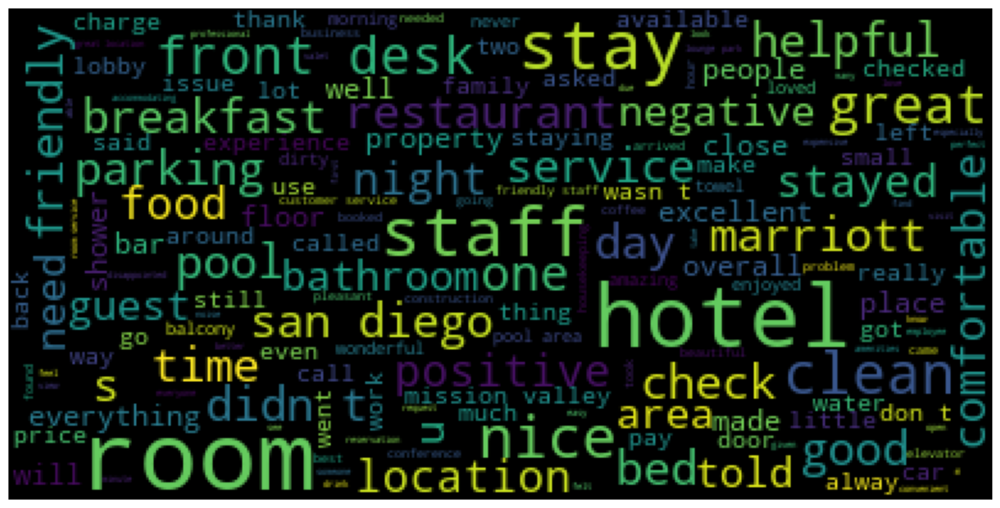

In [42]:
show_wordcloud(df2['text_clean'].values)

In [43]:
fig = make_subplots(rows=1, cols=2, specs=[[{"type": "pie"}, {"type": "bar"}]])
colors = ['gold', 'mediumturquoise', 'lightgreen'] # darkorange
fig.add_trace(go.Pie(labels=df2.label_name.value_counts().index,
                             values=df2.label.value_counts().values), 1, 1)

fig.update_traces(hoverinfo='label+percent', textfont_size=20,
                  marker=dict(colors=colors, line=dict(color='#000000', width=2)))

fig.add_trace(go.Bar(x=df2.label_name.value_counts().index, y=df2.label.value_counts().values, marker_color = colors), 1,2)

fig.show(renderer='iframe')

In [44]:
# when I did this analysis first, I saw that these words were very common, they are not helpful to our review
df2['text_clean'] = df2['text_clean'].str.replace('room','').str.replace('stay','').str.replace('hotel','')

In [45]:
# tokenize data
df2["tokenized_review"] = df2.text_clean.apply(lambda x: tokenize(x))
# calculate token count for any sent
df2["sent_token_length"] = df2["tokenized_review"].apply(lambda x: len(x.split()))

In [46]:
fig = px.histogram(df2, x="sent_token_length", nbins=20, color_discrete_sequence=px.colors.cmocean.algae, barmode='group', histnorm="percent")
fig.show(renderer='iframe')

In [47]:
(df2.sent_token_length < 250).mean()

0.9828486685150558

In [48]:
# finds char count for each review
df2['char_count'] = df2['text_clean'].apply(lambda x: len(str(x)))


def plot_dist3(df, feature, title):
    fig = plt.figure(constrained_layout=True, figsize=(18, 8))
    grid = gridspec.GridSpec(ncols=3, nrows=3, figure=fig)
    ax1 = fig.add_subplot(grid[0, :2])
    ax1.set_title('Histogram')
    sns.distplot(df.loc[:, feature],
                 hist=True,
                 kde=True,
                 ax=ax1,
                 )
    ax1.set(ylabel='Frequency')
    ax1.xaxis.set_major_locator(MaxNLocator(nbins=20))


    plt.suptitle(f'{title}', fontsize=24)

In [49]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 15509 entries, 0 to 22836
Data columns (total 8 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   review_score       15509 non-null  float64
 1   text               15509 non-null  object 
 2   label              15509 non-null  int64  
 3   label_name         15509 non-null  object 
 4   text_clean         15509 non-null  object 
 5   tokenized_review   15509 non-null  object 
 6   sent_token_length  15509 non-null  int64  
 7   char_count         15509 non-null  int64  
dtypes: float64(1), int64(3), object(4)
memory usage: 1.1+ MB


In [50]:
df2.head()

,review_score,text,label,label_name,text_clean,tokenized_review,sent_token_length,char_count
0,3.0,"Stay was alright, but the shower was scolding ...",1,Neutral,was alright but the shower was scolding hot ...,was alright but the shower was scolding hot an...,109,515
1,1.0,My boyfriend had gotten us a room here after a...,0,Negative,my boyfriend had gotten us a here after a non...,my boyfriend had gotten us a here after a nons...,115,542
2,5.0,We were very comfortable during our stay. The ...,2,Positive,we were very comfortable during our the desk...,we were very comfortable during our the desk s...,17,108
3,5.0,"Clean comfortable room, very friendly and help...",2,Positive,clean comfortable very friendly and helpful ...,clean comfortable very friendly and helpful st...,20,123
4,2.0,I checked in and the room I was not able to ge...,0,Negative,i checked in and the i was not able to get it...,i checked in and the i was not able to get it ...,141,708


/tmp/ipykernel_2367/1297829534.py:10: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



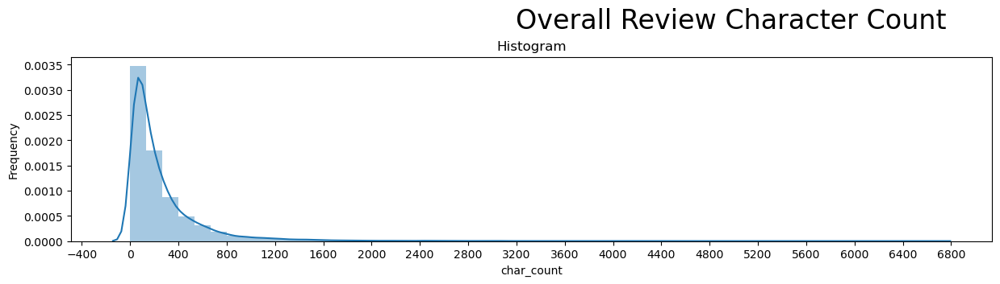

In [51]:
plot_dist3(df2, 'char_count',
           'Overall Review Character Count')

In [52]:
# Creating a new feature for the visualization.
df2['Character Count'] = df2['text_clean'].apply(lambda x: len(str(x)))


def plot_dist3(df, feature, title):
    # Creating a customized chart. and giving in figsize and everything.
    fig = plt.figure(constrained_layout=True, figsize=(24, 12))
    # Creating a grid of 3 cols and 3 rows.
    grid = gridspec.GridSpec(ncols=3, nrows=3, figure=fig)

    # Customizing the histogram grid.
    ax1 = fig.add_subplot(grid[0, :2])
    # Set the title.
    ax1.set_title('Histogram')
    # plot the histogram.
    sns.distplot(df.loc[:, feature],
                 hist=True,
                 kde=True,
                 ax=ax1,
                 color='#e74c3c')
    ax1.set(ylabel='Frequency')
    ax1.xaxis.set_major_locator(MaxNLocator(nbins=20))

    # Customizing the ecdf_plot.
    ax2 = fig.add_subplot(grid[1, :2])
    # Set the title.
    ax2.set_title('Empirical CDF')
    # Plotting the ecdf_Plot.
    sns.distplot(df.loc[:, feature],
                 ax=ax2,
                 kde_kws={'cumulative': True},
                 hist_kws={'cumulative': True},
                 color='#e74c3c')
    ax2.xaxis.set_major_locator(MaxNLocator(nbins=20))
    ax2.set(ylabel='Cumulative Probability')

    plt.suptitle(f'{title}', fontsize=24)

/tmp/ipykernel_2367/2999389183.py:16: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/tmp/ipykernel_2367/2999389183.py:29: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to us

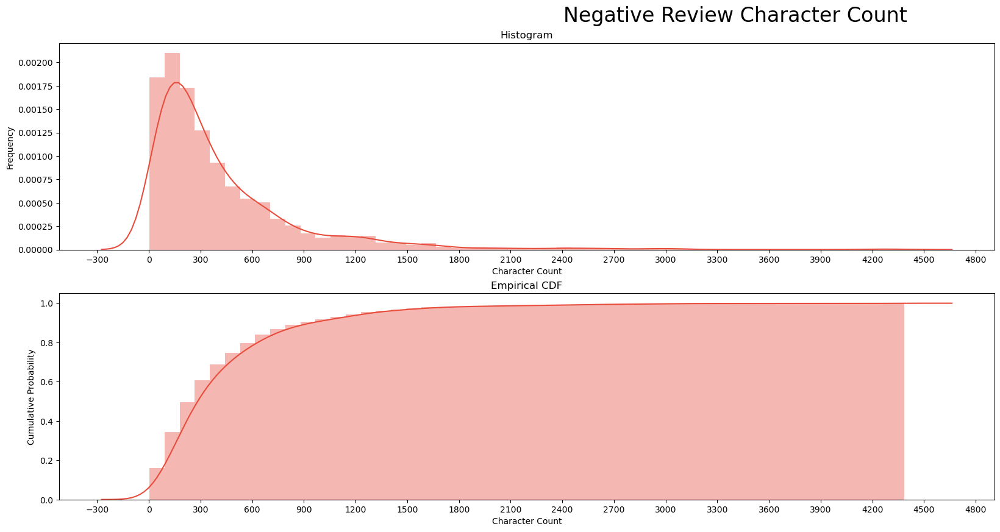

In [53]:
plot_dist3(df2[df2['label'] == 0], 'Character Count',
           'Negative Review Character Count')

/tmp/ipykernel_2367/2999389183.py:16: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/tmp/ipykernel_2367/2999389183.py:29: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to us

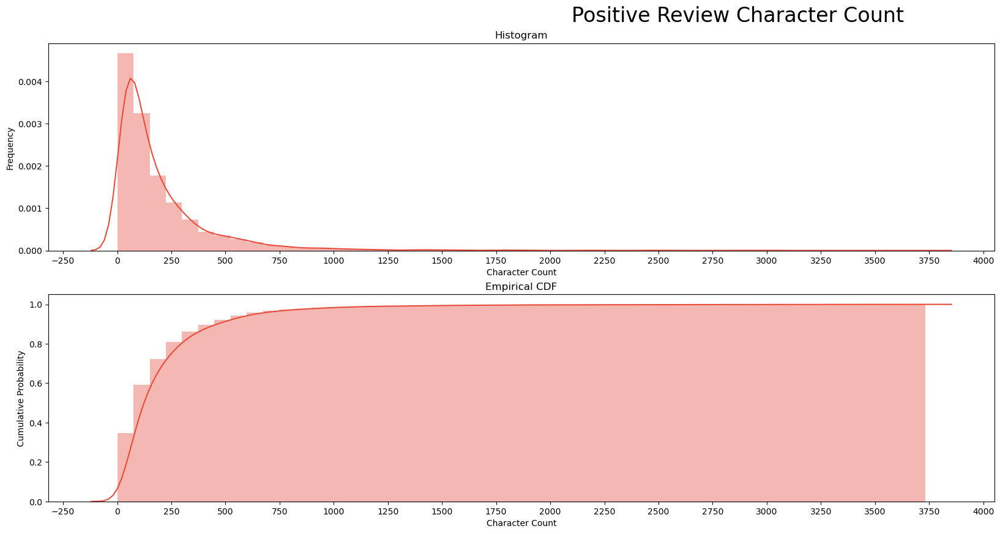

In [54]:
plot_dist3(df2[df2['label'] == 2], 'Character Count',
           'Positive Review Character Count')

/tmp/ipykernel_2367/2999389183.py:16: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/tmp/ipykernel_2367/2999389183.py:29: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to us

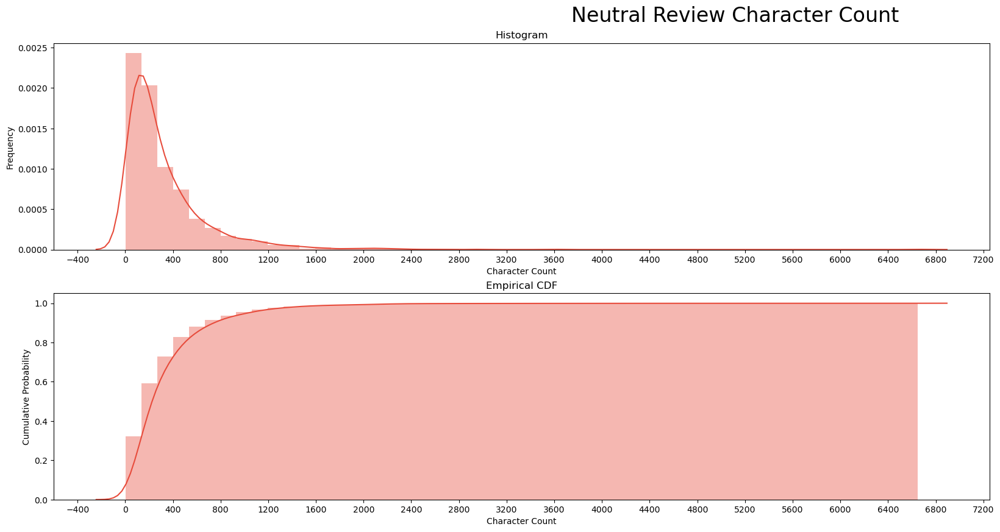

In [55]:
plot_dist3(df2[df2['label'] == 1], 'Character Count',
           'Neutral Review Character Count')

In [56]:
#compare word counts for each type of review to each other
def plot_word_number_histogram(textno, textye, textz):
    
    """A function for comparing word counts"""

    fig, axes = plt.subplots(ncols=1, nrows=3, figsize=(18, 12), sharey=True)
    sns.distplot(textno.str.split().map(lambda x: len(x)), ax=axes[0], color='#e74c3c')
    sns.distplot(textye.str.split().map(lambda x: len(x)), ax=axes[1], color='#e74c3c')
    sns.distplot(textz.str.split().map(lambda x: len(x)), ax=axes[2], color='#e74c3c')

    
    axes[0].set_xlabel('Word Count')
    axes[0].set_ylabel('Frequency')
    axes[0].set_title('Negative')
    axes[1].set_xlabel('Word Count')
    axes[1].set_title('Netrual')
    axes[2].set_xlabel('Word Count')
    axes[2].set_title('Positive')
    
    fig.suptitle('Words Per Review', fontsize=24, va='baseline')
    
    fig.tight_layout()

/tmp/ipykernel_2367/2719253186.py:7: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/tmp/ipykernel_2367/2719253186.py:8: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use 

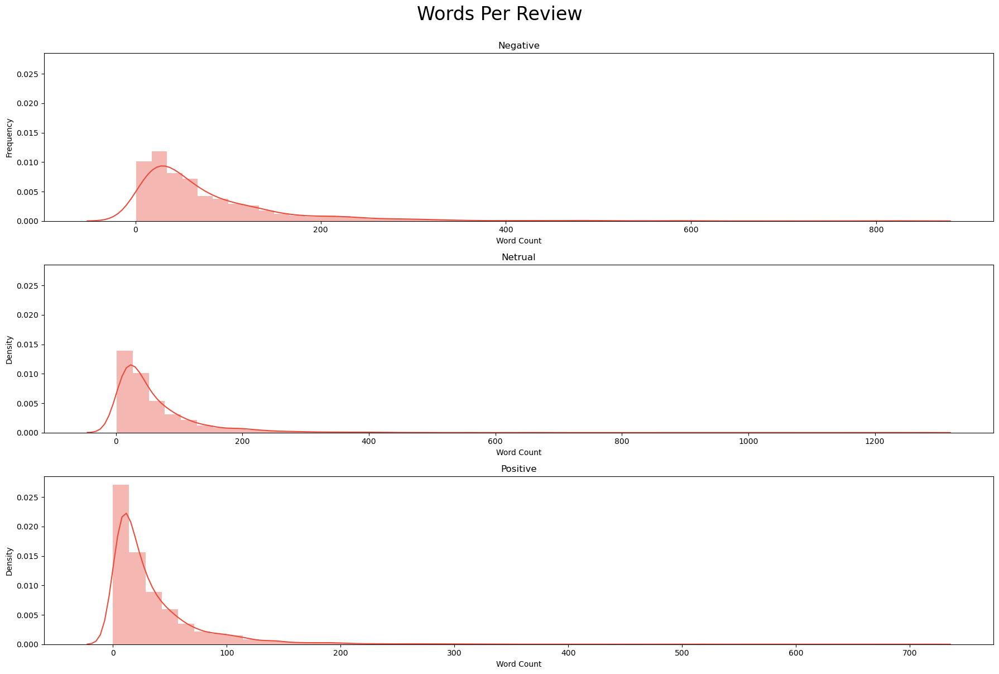

In [57]:
plot_word_number_histogram(df2[df2['label'] == 0]['text_clean'],
                           df2[df2['label'] == 1]['text_clean'],
                           df2[df2['label'] == 2]['text_clean'],
                          )

In [58]:
# remove punk
df2['tokenized_review'] = df2['tokenized_review'].apply(lambda x: remove_punct(x))

In [59]:
texts = df2['tokenized_review']
new = texts.str.split()
new = new.values.tolist()
corpus = [word for i in new for word in i]
counter = Counter(corpus)
most = counter.most_common()
x, y = [], []
for word, count in most[:40]:
    if word not in stopWords_nltk:
        x.append(word)
        y.append(count)

fig = go.Figure(go.Bar(
            x=y,
            y=x,
            orientation='h',  marker=dict(
        color='rgba(50, 171, 96, 0.6)',
        line=dict(
            color='rgba(50, 171, 96, 1.0)',
            width=1),
    ),
    name='Most common Word',))

fig.update_layout( title={
        'text': "Most Common Words",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'}, font=dict(
        family="Courier New, monospace",
        size=18,
        color="RebeccaPurple"
    ))

fig.show(renderer='iframe')

In [60]:
fig = make_subplots(rows=1, cols=3)
title_ = ["negative", "neutral", "positive"]

for i in range(3):
    texts = df2[df2["label"] == i]['tokenized_review']

    new = texts.str.split()
    new = new.values.tolist()
    corpus = [word for i in new for word in i]
    counter = Counter(corpus)
    most = counter.most_common()
    x, y = [], []

    for word, count in most[:40]:
        if word not in stopWords_nltk:
            x.append(word)
            y.append(count)

    fig.add_trace(go.Bar(
                x=y,
                y=x,
                orientation='h', type="bar",
        name=title_[i], marker=dict(color=colors[i])), 1, i+1)
    
fig.update_layout(
    autosize=False,
    width=2000,
    height=600,title=dict(
        text='<b>Most Common ngrams per Classes</b>',
        x=0.5,
        y=0.95,
        font=dict(
        family="Courier New, monospace",
        size=24,
        color="RebeccaPurple"
        )
    ),)


fig.show(renderer='iframe')

In [61]:
df2.head()

,review_score,text,label,label_name,text_clean,tokenized_review,sent_token_length,char_count,Character Count
0,3.0,"Stay was alright, but the shower was scolding ...",1,Neutral,was alright but the shower was scolding hot ...,was alright but the shower was scolding hot an...,109,515,515
1,1.0,My boyfriend had gotten us a room here after a...,0,Negative,my boyfriend had gotten us a here after a non...,my boyfriend had gotten us a here after a nons...,115,542,542
2,5.0,We were very comfortable during our stay. The ...,2,Positive,we were very comfortable during our the desk...,we were very comfortable during our the desk s...,17,108,108
3,5.0,"Clean comfortable room, very friendly and help...",2,Positive,clean comfortable very friendly and helpful ...,clean comfortable very friendly and helpful st...,20,123,123
4,2.0,I checked in and the room I was not able to ge...,0,Negative,i checked in and the i was not able to get it...,i checked in and the i was not able to get it ...,141,708,708


In [62]:
def _get_top_ngram(corpus, n=None):
    #getting top ngrams
    vec = CountVectorizer(ngram_range=(n, n),
                          max_df=0.9,
                          ).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0)
    words_freq = [(word, sum_words[0, idx])
                  for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
    return words_freq[:20]

In [63]:
# unigram
fig = make_subplots(rows=1, cols=3)

title_ = ["negative", "neutral", "positive"]

for i in range(3):
    texts = df2[df2["label"] == i]['tokenized_review']

    new = texts.str.split()
    new = new.values.tolist()
    corpus = [word for i in new for word in i]
    top_n_bigrams = _get_top_ngram(texts, 2)[:15]
    x, y = map(list, zip(*top_n_bigrams))


    fig.add_trace(go.Bar(
                x=y,
                y=x,
                orientation='h', type="bar",
        name=title_[i], marker=dict(color=colors[i])), 1, i+1)
    

fig.update_layout(
    autosize=False,
    width=2000,
    height=600,title=dict(
        text='<b>Most Common unigrams per Classes</b>',
        x=0.5,
        y=0.95,
        font=dict(
        family="Courier New, monospace",
        size=24,
        color="RebeccaPurple"
        )
    ))      
fig.show(renderer='iframe')

In [64]:
#trigram

fig = make_subplots(rows=1, cols=3)
title_ = ["negative", "neutral", "positive"]

for i in range(3):
    texts = df2[df2["label"] == i]['tokenized_review']

    new = texts.str.split()
    new = new.values.tolist()
    corpus = [word for i in new for word in i]

    top_n_bigrams = _get_top_ngram(texts, 3)[:15]
    x, y = map(list, zip(*top_n_bigrams))

    fig.add_trace(go.Bar(
                x=y,
                y=x,
                orientation='h', type="bar",
        name=title_[i], marker=dict(color=colors[i])), 1, i+1),

fig.update_layout(
    autosize=False,
    width=2000,
    height=600,title=dict(
        text='<b>Most Common trigrams per Classes</b>',
        x=0.5,
        y=0.95,
        font=dict(
        family="Courier New, monospace",
        size=24,
        color="RebeccaPurple"
        )
    ))
    
fig.show(renderer='iframe')

In [65]:
df2.head()

,review_score,text,label,label_name,text_clean,tokenized_review,sent_token_length,char_count,Character Count
0,3.0,"Stay was alright, but the shower was scolding ...",1,Neutral,was alright but the shower was scolding hot ...,was alright but the shower was scolding hot an...,109,515,515
1,1.0,My boyfriend had gotten us a room here after a...,0,Negative,my boyfriend had gotten us a here after a non...,my boyfriend had gotten us a here after a nons...,115,542,542
2,5.0,We were very comfortable during our stay. The ...,2,Positive,we were very comfortable during our the desk...,we were very comfortable during our the desk s...,17,108,108
3,5.0,"Clean comfortable room, very friendly and help...",2,Positive,clean comfortable very friendly and helpful ...,clean comfortable very friendly and helpful st...,20,123,123
4,2.0,I checked in and the room I was not able to ge...,0,Negative,i checked in and the i was not able to get it...,i checked in and the i was not able to get it ...,141,708,708


## Model Work

In [66]:
df2.head()

,review_score,text,label,label_name,text_clean,tokenized_review,sent_token_length,char_count,Character Count
0,3.0,"Stay was alright, but the shower was scolding ...",1,Neutral,was alright but the shower was scolding hot ...,was alright but the shower was scolding hot an...,109,515,515
1,1.0,My boyfriend had gotten us a room here after a...,0,Negative,my boyfriend had gotten us a here after a non...,my boyfriend had gotten us a here after a nons...,115,542,542
2,5.0,We were very comfortable during our stay. The ...,2,Positive,we were very comfortable during our the desk...,we were very comfortable during our the desk s...,17,108,108
3,5.0,"Clean comfortable room, very friendly and help...",2,Positive,clean comfortable very friendly and helpful ...,clean comfortable very friendly and helpful st...,20,123,123
4,2.0,I checked in and the room I was not able to ge...,0,Negative,i checked in and the i was not able to get it...,i checked in and the i was not able to get it ...,141,708,708


In [67]:
from nltk.stem.porter import PorterStemmer

porter=PorterStemmer()

In [68]:
def tokenizer_porter(text):
    return [porter.stem(word) for word in text.split()]

In [69]:
stop=stopwords.words('english')

In [70]:
from sklearn.feature_extraction.text import TfidfVectorizer

tfidf=TfidfVectorizer(strip_accents=None,lowercase=False,preprocessor=None,tokenizer=tokenizer_porter,use_idf=True,norm='l2',smooth_idf=True)

In [71]:
y=df2.label.values
x=tfidf.fit_transform(df2.text_clean)

/opt/conda/lib/python3.11/site-packages/sklearn/feature_extraction/text.py:525: UserWarning:

The parameter 'token_pattern' will not be used since 'tokenizer' is not None'



In [72]:
from sklearn.model_selection import train_test_split

X_train,X_test,y_train,y_test=train_test_split(x,y,random_state=1,test_size=0.2,shuffle=False)

In [73]:
from sklearn.linear_model import LogisticRegressionCV

clf=LogisticRegressionCV(cv=6,scoring='accuracy',random_state=0,n_jobs=-1,verbose=3,max_iter=500).fit(X_train,y_train)

y_pred = clf.predict(X_test)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


      4.6818D-04 -8.0993D-05 -3.8719D-04  0.0000D+00  0.0000D+00  0.0000D+00
     -5.0935D-05  5.5521D-05 -4.5859D-06  0.0000D+00  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00  0.0000D+00  6.8519D-05 -1.2303D-05 -5.6216D-05
      0.0000D+00  0.0000D+00  0.0000D+00  2.7882D-04  1.1690D-04 -3.9573D-04
      2.2793D-04 -3.8885D-05 -1.8904D-04 -4.8278D-04 -3.0009D-04  7.8288D-04
      0.0000D+00  0.0000D+00  0.0000D+00 -2.8362D-05 -1.9912D-05  4.8274D-05
      3.2705D-03  3.8406D-03 -7.1111D-03  0.0000D+00  0.0000D+00  0.0000D+00
      3.6602D-04  5.9335D-04 -9.5937D-04  0.0000D+00  0.0000D+00  0.0000D+00
      1.5081D-04  1.4649D-04 -2.9730D-04  0.0000D+00  0.0000D+00  0.0000D+00
      2.2446D-04  2.7302D-04 -4.9748D-04 -2.2641D-05 -1.5795D-05  3.8437D-05
     -3.1430D-05 -1.1103D-04  1.4246D-04 -1.7339D-04  2.4247D-05  1.4915D-04
      8.9556D-04  4.9159D-05 -9.4472D-04 -2.5615D-05 -1.7717D-05  4.3332D-05
     -3.3487D-05  1.4299D-04 -1.0950D-04  1.7434D-04  6.5707D-05 -2.4005D-04

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


      0.0000D+00  0.0000D+00  0.0000D+00 -1.0672D-02 -2.1678D-02  3.2350D-02
     -3.2028D-03  2.7959D-03  4.0689D-04  3.6977D-03 -2.6079D-03 -1.0898D-03
      0.0000D+00  0.0000D+00  0.0000D+00  8.0514D-02 -6.9807D-02 -1.0707D-02
      0.0000D+00  0.0000D+00  0.0000D+00  2.8088D-03 -1.1235D-03 -1.6853D-03
      6.5094D-04  3.6521D-02 -3.7171D-02 -4.4100D-03 -2.9201D-03  7.3301D-03
      0.0000D+00  0.0000D+00  0.0000D+00 -2.2998D-03  7.2902D-03 -4.9905D-03
      9.9597D-03 -8.8438D-03 -1.1159D-03 -9.1319D-03 -7.7245D-03  1.6856D-02
     -3.0759D-03 -3.2450D-03  6.3209D-03 -2.6782D-03  6.9431D-03 -4.2649D-03
      3.1564D-02  4.7275D-03 -3.6292D-02  0.0000D+00  0.0000D+00  0.0000D+00
      9.7641D-03 -2.2125D-03 -7.5516D-03 -1.3522D-02 -8.4653D-03  2.1987D-02
     -3.6041D-03 -1.8015D-02  2.1619D-02 -1.0899D-03  2.7809D-03 -1.6911D-03
     -1.9127D-02 -1.7225D-02  3.6351D-02  0.0000D+00  0.0000D+00  0.0000D+00
     -1.7245D-03 -1.5302D-03  3.2546D-03 -2.4195D-03 -1.7355D-03  4.1550D-03

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.




ITERATION    28

----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.0689900464683468     

At iterate   19    f=  4.48739D+03    |proj g|=  4.81270D+01


ITERATION    20

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    3.1256504027606256     

At iterate   14    f=  4.73533D+03    |proj g|=  1.11464D+02


ITERATION    15

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.28914591028716302     

At iterate   28    f=  4.41362D+03    |proj g|=  1.16703D+01


ITERATION    29

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    4.0916100885737343  

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.62162990003251639     

At iterate  134    f=  2.80044D+03    |proj g|=  4.87821D+00


ITERATION   135

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.34733487901063792     

At iterate  118    f=  2.70118D+03    |proj g|=  2.37425D+00


ITERATION   119

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.35808202909040526     

At iterate  160    f=  2.73187D+03    |proj g|=  6.35957D+00

----------------exit SUBSM --------------------



ITERATION   161
 LINE SEARCH           0  times; norm of step =   0.12143629818082260     


----------------SUBSM entered-----------------

At iterate  149    f=  2.74889D+03    |proj g|=  1.55939D+00


ITERATION   150

----------------exit SUBSM ------

 This problem is unconstrained.
 This problem is unconstrained.



----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    4.1489100391429515E-003

At iterate  340    f=  2.74705D+03    |proj g|=  7.50005D-02


ITERATION   341
 LINE SEARCH           0  times; norm of step =    55.636807707137059     

At iterate    2    f=  1.78337D+03    |proj g|=  5.51172D+01


ITERATION     3

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    7.1954350455830356E-003

At iterate  310    f=  2.69797D+03    |proj g|=  4.97960D-02


ITERATION   311
 LINE SEARCH           1  times; norm of step =    3.4421050636190493E-003

At iterate  326    f=  2.79783D+03    |proj g|=  7.56477D-02


ITERATION   327

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM ------

 This problem is unconstrained.
 This problem is unconstrained.




ITERATION    39
 LINE SEARCH           0  times; norm of step =    2.1799597609206680     

At iterate   65    f=  1.43562D+03    |proj g|=  2.83258D+00

----------------SUBSM entered-----------------



ITERATION    66
 LINE SEARCH           0  times; norm of step =    2.7633245695437383     

At iterate   19    f=  1.57644D+03    |proj g|=  2.05807D+00


ITERATION    20
 LINE SEARCH           0  times; norm of step =    8.6320002825150510     

At iterate   10    f=  1.60756D+03    |proj g|=  1.67623D+01

----------------exit SUBSM --------------------



ITERATION    11

----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.4867157484440496     

At iterate   66    f=  1.43336D+03    |proj g

/opt/conda/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
 This problem is unconstrained.
/opt/conda/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#log


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    5.6527158900000138E-002

At iterate  468    f=  1.38080D+03    |proj g|=  1.56773D-01


ITERATION   469

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    4.0178690850767612E-002

At iterate  469    f=  1.41868D+03    |proj g|=  8.92476D-02


ITERATION   470
 LINE SEARCH           0  times; norm of step =    5.0298690556162696E-003

At iterate  488    f=  1.46108D+03    |proj g|=  9.21268D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =        29547     M =           10

At X0         0 variables are exactly at the bounds


ITERATION   489

At iterate    0    f=  9.50216D+02    |proj g|=  9.13366D-02


ITERATION     1

---------------- CAUCHY entered-------------------
 There are            0   breakpoints

/opt/conda/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/conda/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

 LINE SEARCH           0  times; norm of step =    14.027680290965133     

At iterate   26    f=  7.01192D+02    |proj g|=  7.17188D+00


ITERATION    27
 LINE SEARCH           0  times; norm of step =   0.43401341889797607     

At iterate   62    f=  6.70837D+02    |proj g|=  7.69094D-01


ITERATION    63
 LINE SEARCH           0  times; norm of step =    4.1617801086246633     

At iterate   41    f=  7.33169D+02    |proj g|=  1.76381D+00

----------------SUBSM entered-----------------



ITERATION    42

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    7.7152292730092071     

At iterate   26    f=  7.29239D+02    |proj g|=  4.82430D+00


ITERATION    27

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM ------

 This problem is unconstrained.




ITERATION   483
 LINE SEARCH           0  times; norm of step =   0.65366421101553795     

At iterate  473    f=  6.49237D+02    |proj g|=  1.78605D-01


ITERATION   474

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.33292816213312892     

At iterate  478    f=  6.14834D+02    |proj g|=  2.00923D-01


ITERATION   479

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.90714112666663427     

At iterate    6    f=  4.10004D+02    |proj g|=  1.26908D+00

----------------exit SUBSM --------------------



ITERATION     7

----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.17290789039660176     

At iterate  483    f=  6.73975D+02    |proj g

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


 LINE SEARCH           0  times; norm of step =   0.15919757888562386     

At iterate    3    f=  4.43378D+02    |proj g|=  2.13515D+00


ITERATION     4

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =    2.5249772278752713     

At iterate   40    f=  3.27787D+02    |proj g|=  3.13486D+00

----------------exit SUBSM --------------------



ITERATION    41

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.29621465900059452     

At iterate    4    f=  4.43274D+02    |proj g|=  3.24297D+00


ITERATION     5

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    7.2151658468579445     

At iterate   41    f=  3.26983D+02    |proj g|=  4.24620D+00


ITERATION    42

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 This problem is unconstrained.
 This problem is unconstrained.
IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)

 This problem is unconstrained.
[Parallel(n_jobs=-1)]: Done   2 out of   6 | elapsed:   15.1s remaining:   30.1s
 This problem is unconstrained.
 This problem is unconstrained.


       29547  variables are free at GCP            1
 LINE SEARCH           0  times; norm of step =    1.0000000000000000     

At iterate    1    f=  7.87457D+03    |proj g|=  1.50125D+02


ITERATION     2

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.0000000000000000     

At iterate    1    f=  9.24388D+03    |proj g|=  7.09988D+02


ITERATION     2

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.43120259154080726     

At iterate    2    f=  8.93884D+03    |proj g|=  2.64747D+02


ITERATION     3

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    1.8845306841181315     

At iterate    2    f=  7.65560D+03    |proj g|=  5.92417D+02


ITERATION     3

----------------SUBSM entered

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.10130478028059677     

At iterate    5    f=  8.41704D+03    |proj g|=  3.17847D+01


ITERATION     6

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    7.6552469497159187E-002

At iterate    6    f=  8.41626D+03    |proj g|=  7.13864D+00


ITERATION     7

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.3713350151398695E-002

At iterate    7    f=  8.41622D+03    |proj g|=  3.06066D-01


ITERATION     8

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.0867648980392955E-003

At iterate    8    f=  8.41622D+03    |proj g|=  2.37494D-01




IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



 LINE SEARCH           0  times; norm of step =   0.51665177225339276     

At iterate  132    f=  2.70380D+03    |proj g|=  3.61409D+00


ITERATION   133
 LINE SEARCH           0  times; norm of step =   0.61195231864295374     

At iterate  105    f=  2.67143D+03    |proj g|=  4.59049D+00


ITERATION   106

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.8787725088210541     

At iterate  106    f=  2.67109D+03    |proj g|=  2.47188D+01


ITERATION   107

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.25465495722182857     

At iterate  133    f=  2.70374D+03    |proj g|=  7.23940D+00


ITERATION   134

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 This problem is unconstrained.
 This problem is unconstrained.



----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    11.508315178447537     

At iterate   13    f=  1.56161D+03    |proj g|=  1.93980D+01


ITERATION    14

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    6.5263127926223499     

At iterate   14    f=  1.55738D+03    |proj g|=  1.37814D+01


ITERATION    15

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    2.4680328396657805     

At iterate   15    f=  1.55535D+03    |proj g|=  2.91449D+01


ITERATION    16

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    5.3563759572008776     

At iterate   16    f=  1.54968D+03    |proj g|=  1.55397D+01




/opt/conda/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
 This problem is unconstrained.
/opt/conda/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#log

 LINE SEARCH           0  times; norm of step =    2.0447460630908850E-002

At iterate  492    f=  1.39168D+03    |proj g|=  2.99207D-02
 LINE SEARCH           0  times; norm of step =    39.297565887626760     

At iterate    4    f=  8.45718D+02    |proj g|=  7.69367D+01


ITERATION     5


ITERATION   493

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    49.199831927451704     

At iterate    5    f=  8.03991D+02    |proj g|=  6.17415D+01


ITERATION     6

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.3092641788729561E-002

At iterate  493    f=  1.39168D+03    |proj g|=  8.72263D-02


ITERATION   494

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 This problem is unconstrained.



----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.3169360940253072     

At iterate    3    f=  3.75306D+02    |proj g|=  2.86281D+00


ITERATION     4

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.15309236637266010     

At iterate  481    f=  6.35227D+02    |proj g|=  5.25514D-01


ITERATION   482

----------------SUBSM entered-----------------

 LINE SEARCH           0  times; norm of step =   0.26127080937821862     

At iterate    4    f=  3.75120D+02    |proj g|=  1.92829D+00


ITERATION     5

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    8.1495614796130503E-002

At iterate  482    f=  6.35223D+02    |proj g|=  5.71881D-01
 L

 This problem is unconstrained.



----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.50708323643813658     

At iterate    4    f=  4.11483D+02    |proj g|=  9.32058D-01


ITERATION     5
 LINE SEARCH           0  times; norm of step =    1.9820743602768569     

At iterate   40    f=  2.76854D+02    |proj g|=  2.36673D+00


ITERATION    41

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------


----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.3784626154435795     

At iterate    5    f=  4.11101D+02    |proj g|=  3.06681D+00


ITERATION     6

----------------SUBSM entered-----------------


 LINE SEARCH           0  times; norm of step =    9.7819363373885615     
----------------exit SUBSM --------------------


At iterate   41    f=  2.76700D+02    |proj g|=  3.10977D+00


ITERATION    42

----------------SUBSM entered---

[Parallel(n_jobs=-1)]: Done   6 out of   6 | elapsed:   28.2s finished
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =        29547     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.27371D+03    |proj g|=  3.15159D+01

At iterate    1    f=  5.27327D+03    |proj g|=  1.31056D+00

At iterate    2    f=  5.27325D+03    |proj g|=  8.77566D-01

At iterate    3    f=  5.27299D+03    |proj g|=  1.38192D+01

At iterate    4    f=  5.27257D+03    |proj g|=  2.61408D+01

At iterate    5    f=  5.27157D+03    |proj g|=  4.08385D+01

At iterate    6    f=  5.27027D+03    |proj g|=  4.16502D+01

At iterate    7    f=  5.26913D+03    |proj g|=  7.06572D+01

At iterate    8    f=  5.26645D+03    |proj g|=  3.33873D+01

At iterate    9    f=  5.26311D+03    |proj g|=  1.16579D+01

At iterate   10    f=  5.26117D+03    |proj g|=  2.98795D+01

At iterate   11    f=  5.25971D+03    |proj g|=  2.19968D+01

At iterate   12    f=  5.25836D+03    |proj g|=  3.38226D+00

At iterate   13    f=  5.2

In [74]:
from sklearn import metrics

# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.7856221792392005


In [75]:
from sklearn.linear_model import SGDClassifier
clf= SGDClassifier(loss='hinge', penalty='l2', alpha=0.0001, l1_ratio=0.15, fit_intercept=True, 
                   max_iter=1000, tol=0.001, shuffle=True, verbose=0, epsilon=0.1, n_jobs=None, random_state=None, learning_rate='optimal', eta0=0.0, power_t=0.5, 
                   early_stopping=False, validation_fraction=0.1, n_iter_no_change=5, class_weight=None, warm_start=False, average=False)
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)

In [76]:
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.7981947130883301


In [77]:
# models to test later - SVC, Random forest, D tree, SVC
# add cross validation, area under ROC, etc